# Discrete Optimal Transport for Domain Adaptation

## Illustrated using Baroness album covers

In [1]:
import os
from pathlib import Path
import numpy as np
from matplotlib import pyplot as plt
import ot
rng = np.random.RandomState(42)

/home/alal/anaconda3/envs/tf/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def im2mat(img):
    """Converts an image to matrix (one pixel per line)"""
    return img.reshape((img.shape[0] * img.shape[1], img.shape[2]))

def mat2im(X, shape):
    """Converts back a matrix to an image"""
    return X.reshape(shape)

def minmax(img):
    return np.clip(img, 0, 1)

In [3]:
# can make this a command line application
I1 = plt.imread("images/f1.jpg").astype(np.float64) / 256
I2 = plt.imread("images/f2.jpg").astype(np.float64) / 256
X1 = im2mat(I1)
X2 = im2mat(I2)

# training samples
nb = 500
idx1 = rng.randint(X1.shape[0], size=(nb,))
idx2 = rng.randint(X2.shape[0], size=(nb,))

Xs = X1[idx1, :]; Xt = X2[idx2, :]

## Original images

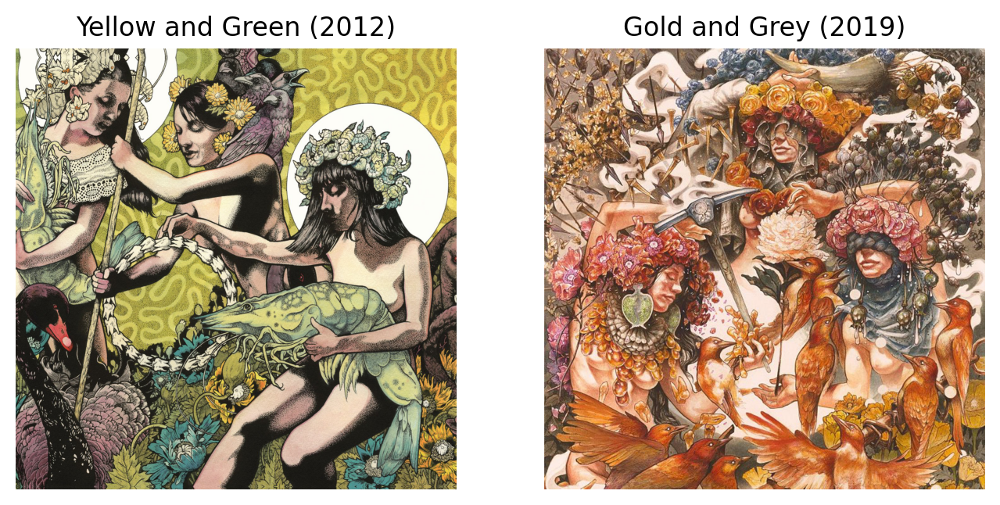

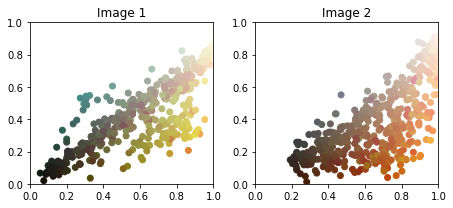

In [7]:
plt.figure(1, figsize=(8, 4), dpi = 200)
plt.subplot(1, 2, 1)
plt.imshow(I1)
plt.axis('off')
plt.title('Yellow and Green (2012)')

plt.subplot(1, 2, 2)
plt.imshow(I2)
plt.axis('off')
plt.title('Gold and Grey (2019)')
# %%
plt.figure(2, figsize=(6.4, 3))
plt.subplot(1, 2, 1)
plt.scatter(Xs[:, 0], Xs[:, 2], c=Xs)
plt.axis([0, 1, 0, 1])
plt.title('Image 1')

plt.subplot(1, 2, 2)
plt.scatter(Xt[:, 0], Xt[:, 2], c=Xt)
plt.axis([0, 1, 0, 1])
plt.title('Image 2')
plt.tight_layout()

## Transport matrix computation

Exact, followed by regularised

In [8]:
# EMDTransport
ot_emd = ot.da.EMDTransport()
ot_emd.fit(Xs=Xs, Xt=Xt)

# SinkhornTransport
ot_sinkhorn = ot.da.SinkhornTransport(reg_e=1e-1)
ot_sinkhorn.fit(Xs=Xs, Xt=Xt)

In [9]:
transp_Xs_emd = ot_emd.transform(Xs=X1)
transp_Xt_emd = ot_emd.inverse_transform(Xt=X2)

transp_Xs_sinkhorn = ot_sinkhorn.transform(Xs=X1)
transp_Xt_sinkhorn = ot_sinkhorn.inverse_transform(Xt=X2)

I1t = minmax(mat2im(transp_Xs_emd, I1.shape))
I2t = minmax(mat2im(transp_Xt_emd, I2.shape))

I1te = minmax(mat2im(transp_Xs_sinkhorn, I1.shape))
I2te = minmax(mat2im(transp_Xt_sinkhorn, I2.shape))

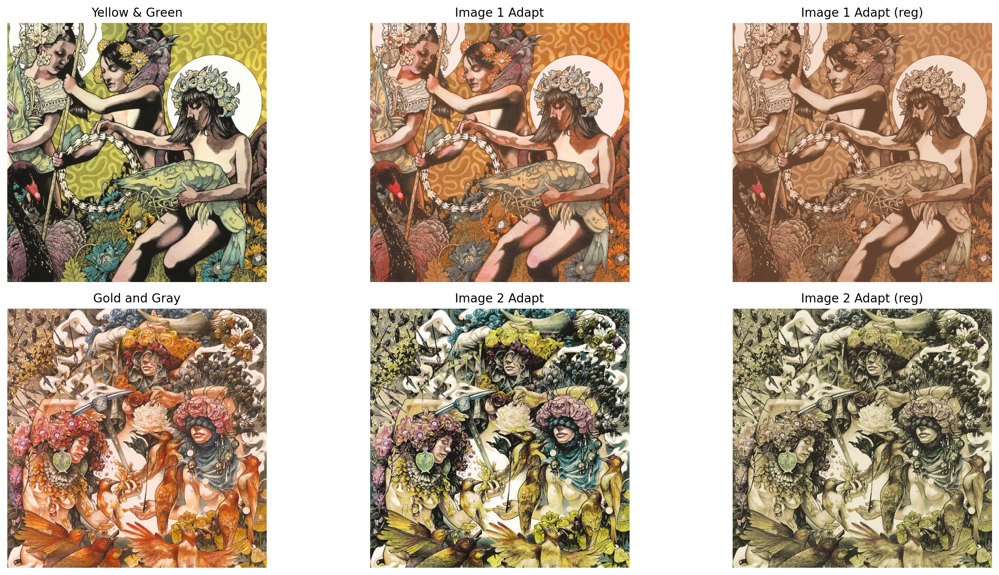

In [10]:
plt.figure(3, figsize=(16, 8), dpi = 200)

plt.subplot(2, 3, 1)
plt.imshow(I1)
plt.axis('off')
plt.title('Yellow & Green')

plt.subplot(2, 3, 2)
plt.imshow(I1t)
plt.axis('off')
plt.title('Image 1 Adapt')

plt.subplot(2, 3, 3)
plt.imshow(I1te)
plt.axis('off')
plt.title('Image 1 Adapt (reg)')

plt.subplot(2, 3, 4)
plt.imshow(I2)
plt.axis('off')
plt.title('Gold and Gray')

plt.subplot(2, 3, 5)
plt.imshow(I2t)
plt.axis('off')
plt.title('Image 2 Adapt')

plt.subplot(2, 3, 6)
plt.imshow(I2te)
plt.axis('off')
plt.title('Image 2 Adapt (reg)')
plt.tight_layout()